In [8]:
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import math

import ellc
from ellc import lc

# import edmcmc as edm
# import batman

In [9]:
def get_star_rv(rv_call_return):
    """
    ellc.rv may return a single array or a tuple (star_rv, planet_rv).
    This helper returns the star RV as a numpy array either way.
    """
    if isinstance(rv_call_return, (tuple, list)):
        return np.asarray(rv_call_return[0])
    return np.asarray(rv_call_return)

In [10]:
# -----------------------
# Data input
# -----------------------
csvfile = "../data/HD97658_2025Feb20.csv"

df = pd.read_csv(csvfile, comment='#')
# ensure columns exist (uses your provided column names)
for col in ("ccfjdsum", "ccfrvmod", "dvrms"):
    if col not in df.columns:
        raise ValueError(f"Input CSV missing required column: {col}")

time_obs = df['ccfjdsum'].values.astype(float)  # times in days
rv_data = df['ccfrvmod'].values.astype(float)   # observed RV in km/s
rv_err = df['dvrms'].values.astype(float)       # RV uncertainties in km/s

In [59]:
r_1 = 0.04132231404
r_2 = 0.0011228161490683
incl = 89.45
a = 24.2
e = 0.05
# f_c and f_s as you requested (note the -10 deg per your line)
f_c = math.sqrt(e) * math.cos(math.radians(-10.0))
f_s = math.sqrt(e) * math.sin(math.radians(-10.0))
q = 0.0000291991764706
t0 = 2460708.91005806
period = 9.489
lambda_1 = -40

vsini_1 = 3.0          # km/s (needed to produce RM). Change to your preferred value.
shape_1 = "sphere"
shape_2 = "sphere"
sbratio = 0.0          # planet contributes negligible light
flux_weighted = True   # compute flux-weighted RV (enables RM)

In [60]:
# -----------------------
# Compute model at observation times
# -----------------------
rv_call = ellc.rv(
    time_obs,
    t_zero=t0,
    q=q,
    vsini_1=vsini_1,
    vsini_2=0.0,
    radius_1=r_1,
    radius_2=r_2,
    incl=incl,
    lambda_1=lambda_1,
    sbratio=sbratio,
    # ld_1=ld_1,
    # ldc_1=ldc_1,
    a=a,
    f_c=f_c,
    f_s=f_s,
    period=period,
    shape_1=shape_1,
    shape_2=shape_2,
    flux_weighted=flux_weighted,
)

star_rv = get_star_rv(rv_call)   # km/s

In [61]:
# -----------------------
# Dense model for smooth plotting
# -----------------------
time_sim = np.linspace(np.min(time_obs), np.max(time_obs), 300)
rv_call_sim = ellc.rv(
    time_sim,
    t_zero=t0,
    q=q,
    # vsini_1=vsini_1,
    vsini_2=0.0,
    radius_1=r_1,
    radius_2=r_2,
    incl=incl,
    lambda_1=lambda_1,
    # sbratio=sbratio,
    # ld_1=ld_1,
    # ldc_1=ldc_1,
    a=a,
    f_c=f_c,
    f_s=f_s,
    period=period,
    # shape_1=shape_1,
    # shape_2=shape_2,
    # flux_weighted=flux_weighted,
)
star_rv_sim = get_star_rv(rv_call_sim)   # km/s

 Start ellc:lc
 N_obs  =          300
 t_obs(1)  =    2460726.7479607500     
 t_obs(N_obs)  =    2460727.0247022500     
 ellc: time_0 =    2460708.9100580602     
 ellc: p_anom =    9.4890000000000008     
 ellc: e =    5.00000007E-02 ; omega_0 =  -0.17453292519943292       radians
 F_rot,1 =   1.0000000000000000     
 F_rot,2 =   1.0000000000000000     
 Star 1, (H_0, H_1, u_H) =    0.00000000       0.00000000       0.00000000    
 Star 2, (H_0, H_1, u_H) =    0.00000000       0.00000000       0.00000000    
 Star 1: n_grid, shape =           16 sphere 
 Star 2: n_grid, shape =           16 sphere 
 Light travel time correction to T_0 =   -6.53950614E-04
 K_1 =    3.77193769E-03  km/s.
 K_2 =    129.179581      km/s.
 Star 1 limiting radius=   0.929862082    
 Star 2 limiting radius=    2.01379303E-02
 t_ecl_to_peri: theta_0 =    1.7453292519943295     
  0.99750000000000005       0.99990785606082211      -0.17453292519943292        4.9999999999999996E-002   9.6590291946287762E-003


In [62]:
# -----------------------
# Align model and data systemic velocity (simple median offset)
# -----------------------
sys_offset = np.median(rv_data) - np.median(star_rv)
star_rv += sys_offset
star_rv_sim += sys_offset

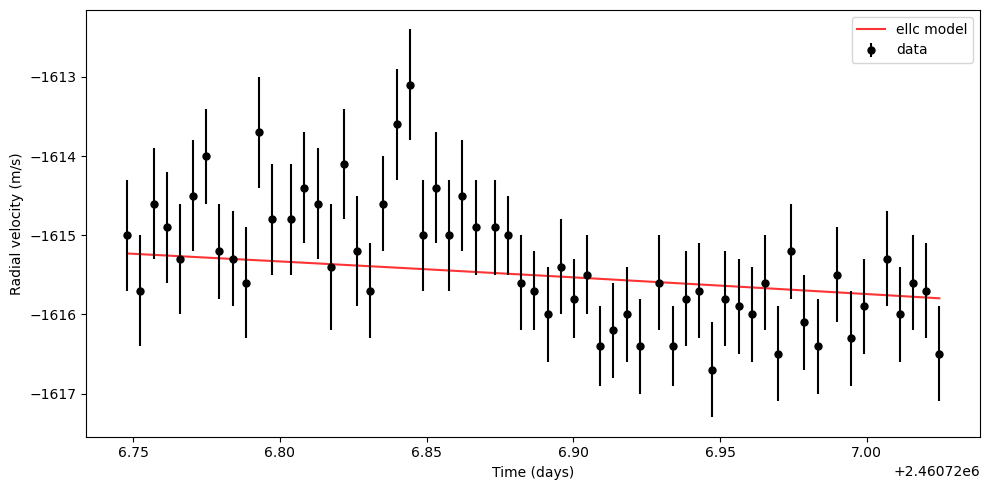

In [63]:
# -----------------------
# Plotting: RV vs time (data + model)
# -----------------------
plt.figure(figsize=(10, 5))
# plot data in m/s
plt.errorbar(time_obs, rv_data * 1e3, yerr=rv_err * 1e3, fmt='o', ms=5, c='k', label='data', zorder=5)
# plot model in m/s
plt.plot(time_sim, star_rv_sim * 1e3, '-', lw=1.5, alpha=0.8, c='red', label='ellc model')

plt.xlabel('Time (days)')
plt.ylabel('Radial velocity (m/s)')
# plt.title('NEID RVs + ellc RM model — HD 97658 (example)')
plt.legend()
plt.tight_layout()
plt.show()